# Overview

This jupyter notebook aims to summarize the total update of CO processes made in 2025 by Aurélien PILUSO (PhD student) in the Meudon PDR Code. 

An additional pdf document with all notes and references are also available along this notebook with the different data needed to run this doc. 

As for changes, we : 
- Used the HITRAN database from 2025 wih Gordon 2022 data to update the Aij, dE(K) and frequencies of radiative transitions
- Used the Stancil file (compared with BaseCol and Ema database and matching data) to update collision rates for CO with H and CO with o/p H2

In this notebook, we will go through the implementation of the update and the check at every step of the validity of the update. 

## 1. Preparation and data loading 


In [1]:
# Libraries importations : 
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd    
import re 
import Functions as fun

pd.set_option("mode.chained_assignment", None)

import plotly.io as pio
pio.renderers.default = "notebook"


#Constant definition in cgs for any conversion
clum= 2.99792458e10
h = 6.62607015e-27
k = 1.380649e-16
cm_k=h*clum/k
cm_GHz=29.9792458
m_GHZ=0.3


    

In [2]:
#Reading of Meudon PDR files for levels, lines and collisions provided with the notebook. The data given are the old data from the Meudon PDR Code 
path="/Users/aurelien/Desktop/PhD/Data/"

root_PDR_Code     = "/Users/aurelien/Desktop/Stage_M2/PDR/1.7/data/"  

rootbase_Coll     = root_PDR_Code + "Collisions/"
rootbase_Levels   = root_PDR_Code + "Levels/"
rootbase_Lines    = root_PDR_Code + "Lines/"

###############################Meudon PDR Files
#Level file
df_level_co = fun.read_energy_levels(rootbase_Levels,"co")         

#Line file
df_line_co = fun.read_lines_df(rootbase_Lines,"co")
df_line_co['Frequency_GHz'] = df_line_co['Description_text'].str.extract('(\d+\.?\d*)\s*GHz')[0].astype(float)

#Collision files
df_co_oh2_Meudon = fun.read_collision_to_df(rootbase_Coll,"co_oh2")   
df_Meudon_oH2 = fun.merge_level_data(df_co_oh2_Meudon, df_level_co,Col_transi=["UP","LOW"], Level_transi=["n","v","J"])  
df_Meudon_oH2 = fun.rename_columns(df_Meudon_oH2)

df_co_ph2_Meudon = fun.read_collision_to_df(rootbase_Coll,"co_ph2")   
df_Meudon_pH2 = fun.merge_level_data(df_co_ph2_Meudon, df_level_co,Col_transi=["UP","LOW"], Level_transi=["n","v","J"])  
df_Meudon_pH2 = fun.rename_columns(df_Meudon_pH2)

df_co_h_Meudon = fun.read_collision_to_df(rootbase_Coll,"co_h")   
df_Meudon_H = fun.merge_level_data(df_co_h_Meudon, df_level_co,Col_transi=["UP","LOW"], Level_transi=["n","v","J"])  
df_Meudon_H = fun.rename_columns(df_Meudon_H)






#################################HITRAN FILE 
name = "CO_HITRAN.dat"

doc = open(path+name,"r")
file_Hitran = doc.read();  ligne_HITRAN = file_Hitran.split("\n");  header = ligne_HITRAN[0:35]

CO_Hitran = ligne_HITRAN[35:len(ligne_HITRAN)-1] #remove last line which is commented 
df_HITRAN = pd.DataFrame([x.split(",") for x in CO_Hitran], 
                       columns = ["Chem_Name", "Mol", "Formula", "lambda_G", "Ref","Aij_G","El(cm-1)","gl","QuantL","Eu(cm-1)","gu","QuantU"])

df_HITRAN[['vu', 'Ju']] = df_HITRAN['QuantU'].apply(fun.extract_v_j).tolist()
df_HITRAN[['vl', 'Jl']] = df_HITRAN['QuantL'].apply(fun.extract_v_j).tolist()
del df_HITRAN["Chem_Name"];del df_HITRAN["Formula"];del df_HITRAN['QuantU'];del df_HITRAN['QuantL']

df_HITRAN[["lambda_G", "Aij_G", "El(cm-1)", "Eu(cm-1)"]] = df_HITRAN[["lambda_G", "Aij_G", "El(cm-1)", "Eu(cm-1)"]].astype(float) #put data into float
df_HITRAN[["gl", "gu","vu","vl","Ju","Jl"]] = df_HITRAN[["gl", "gu","vu","vl","Ju","Jl"]].astype(int) # put data into int 

#New_order=["Mol","lambda_G","Aij_G","gu","Eu(cm-1)","vu","Ju","gl","El(cm-1)","vl","Jl","Ref"]
#df_HITRAN=df_HITRAN.reindex(columns=New_order)

df_HITRAN.sort_values(by=['vu', 'Ju',"vl","Jl"],inplace=True) #for lisibility
df_HITRAN["nu(GHz)_G"] = df_HITRAN["lambda_G"] * cm_GHz

masque = df_HITRAN["Ref"]=="BHSHD-1078 " #Masking to keep only the data from Gordon 2022 
df_Gordon = df_HITRAN[masque]

df_Gordon["Eu(K)"] = df_Gordon["Eu(cm-1)"] * cm_k ; df_Gordon["El(K)"] = df_Gordon["El(cm-1)"] * cm_k
df_Gordon["dE_K_Gordon"] = df_Gordon["Eu(K)"] - df_Gordon["El(K)"]






###################################STANCIL FILE 
root="/Users/aurelien/Desktop/PhD/Data/"
name_stancil = "co_Stancil2024.dat"

#Creation of dataframe for levels 
df_level_Stancil=fun.dat_to_df(root, name_stancil, start_row= 7 , end_row=253,col_names=["n","E[cm-1]","g","J","v"])
df_level_Stancil[["n","g","J","v"]]=df_level_Stancil[["n","g","J","v"]].astype(int)
df_level_Stancil[["E[cm-1]"]] = df_level_Stancil[["E[cm-1]"]].astype(float)


#Get the vu,Ju,vl,Jl from the level data frame with a change in the name in u and l for up and low 
df_level_u = df_level_Stancil.copy()
df_level_u = df_level_u.rename(columns={'n': 'nu'}) 
df_level_u.columns = [col+"u" if col != 'nu' else col for col in df_level_u.columns]
# lower level
df_level_l = df_level_Stancil.copy()
df_level_l = df_level_l.rename(columns={'n': 'nl'}) 
df_level_l.columns = [col+"l" if col != 'nl' else col for col in df_level_l.columns]




#Collision transitions
Col_base = ["ID", "nu", "nl"]
#Grid points for H 
Tvalues_H = [2,5,10,15,20,25,30,40,50,60,70,80,90,100,150,200,250,300,400,500,600,700,800,900,1000,1500,2000,2500,3000]
Col_H = Col_base + [f"{T}Ke" for T in Tvalues_H]
Col_T_H = Col_H[3:]

#Grid points for H2    
Tvalues_H2 = [2,5,10,20,30,40,50,60,70,80,90,100,150,200,300,400,500,600,700,750,800,900,1000,2000,3000]
Col_H2 = Col_base + [f"{T}Ke" for T in Tvalues_H2]
Col_T_H2 = Col_H2[3:]

TGrid_MeudonPDR = [2.,3.,5.,7.,10.,15.,20.,30.,40.,50.,60.,70.,80.,90.,100.,
            150.,200.,300.,400.,500.,600.,700.,800.,900.,1000.,
            1500.,2000.,3000.,5000.,7000.,10000.,15000.,20000.]
Col_T_Meudon = [f"{T}Ke" for T in TGrid_MeudonPDR]
Col_T_Meudon_int = [f"{int(T)}Ke" for T in TGrid_MeudonPDR]
prefix = ["ID","nu","vu","Ju","nl","vl","Jl","gu","gl","E[cm-1]u","E[cm-1]l"] #Adding of vu,Ju,vl,Jl, Eu,El
desired_order_H2 = prefix + [f"{T}Ke" for T in Tvalues_H2]
desired_order_H  = prefix + [f"{T}Ke" for T in Tvalues_H]


df_Stancil_H = fun.Read_Stancil_transitions(root,line_start =12775, endline=29885,
                                Col=Col_H,desired_order=desired_order_H,  df_level_u=df_level_u, df_level_l=df_level_l)

df_Stancil_oH2 = fun.Read_Stancil_transitions(root,line_start =7241, endline=12766,
                                Col=Col_H2,desired_order=desired_order_H2, df_level_u=df_level_u, df_level_l=df_level_l)

df_Stancil_pH2 = fun.Read_Stancil_transitions(root,line_start =1707, endline=7232,
                                Col=Col_H2,desired_order=desired_order_H2,  df_level_u=df_level_u, df_level_l=df_level_l)



## 2. Update HITRAN data 



In [3]:
df_Gordon_renamed = df_Gordon.rename(columns={ 'Aij_G': 'Aij_s-1_Gordon','nu(GHz)_G': 'Frequency_GHz_Gordon'})
#Merge with acurate vu,Ju,vl,Jl originating from the Meudon PDR code and not use the nu,nl nomenclature proper to every code
df_Hitran_final = pd.merge(df_line_co,df_Gordon_renamed[['vu', 'Ju', 'vl', 'Jl', 'dE_K_Gordon', 'Aij_s-1_Gordon', 'Frequency_GHz_Gordon']],
    on=['vu', 'Ju', 'vl', 'Jl'],    how='left')


#####Replacement of old data by HITRAN if possible : 
df_Hitran_final['E_K'] = df_Hitran_final['dE_K_Gordon'].fillna(df_Hitran_final['E_K'])
df_Hitran_final['Aij_s-1'] = df_Hitran_final['Aij_s-1_Gordon'].fillna(df_Hitran_final['Aij_s-1'])
df_Hitran_final['Frequency_GHz'] = df_Hitran_final['Frequency_GHz_Gordon'].fillna(df_Hitran_final['Frequency_GHz'])

df_Hitran_final = df_Hitran_final.drop(columns=['dE_K_Gordon', 'Aij_s-1_Gordon', 'Frequency_GHz_Gordon'])
print("DataFrame combined and updated !")

#To sort them
sort_keys = ['vu', 'Ju', 'vl', 'Jl']
df_co_sorted = df_line_co.sort_values(by=sort_keys).reset_index(drop=True)
df_Hitran_final_sorted = df_Hitran_final.sort_values(by=sort_keys).reset_index(drop=True)


DataFrame combined and updated !


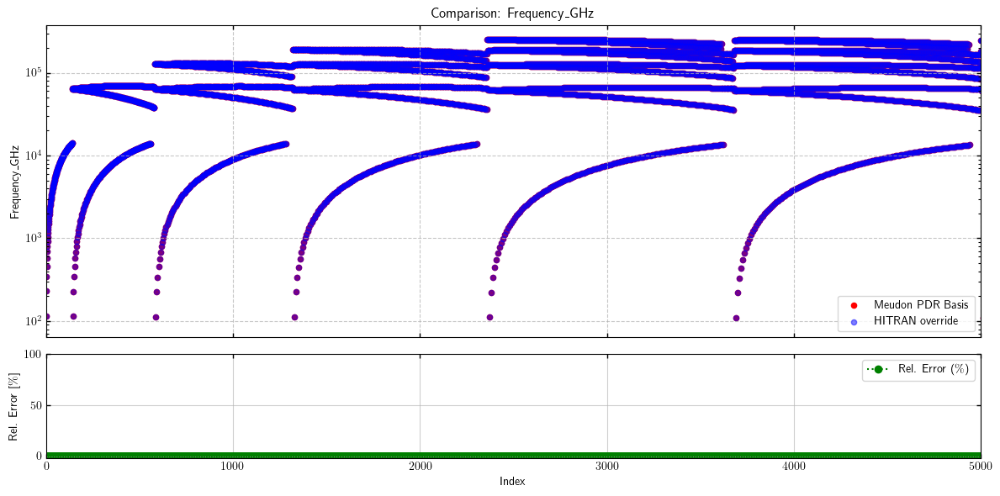

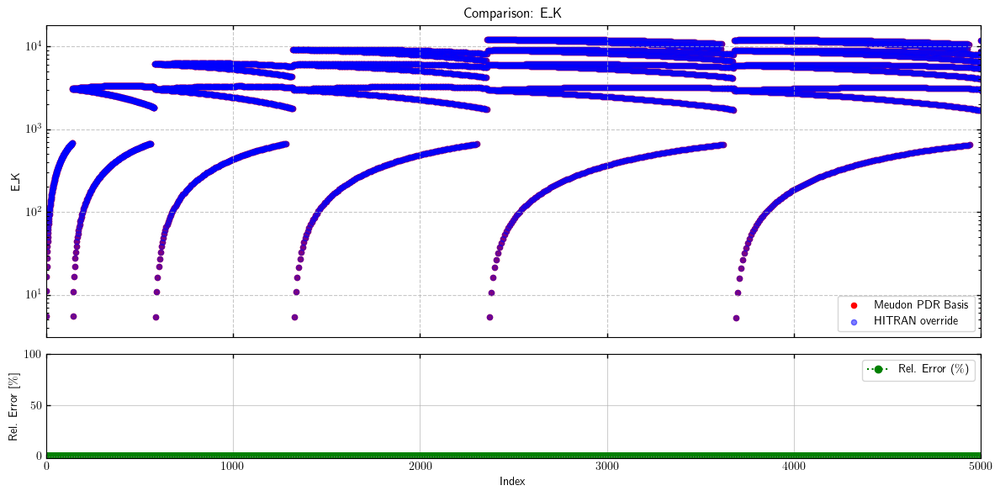

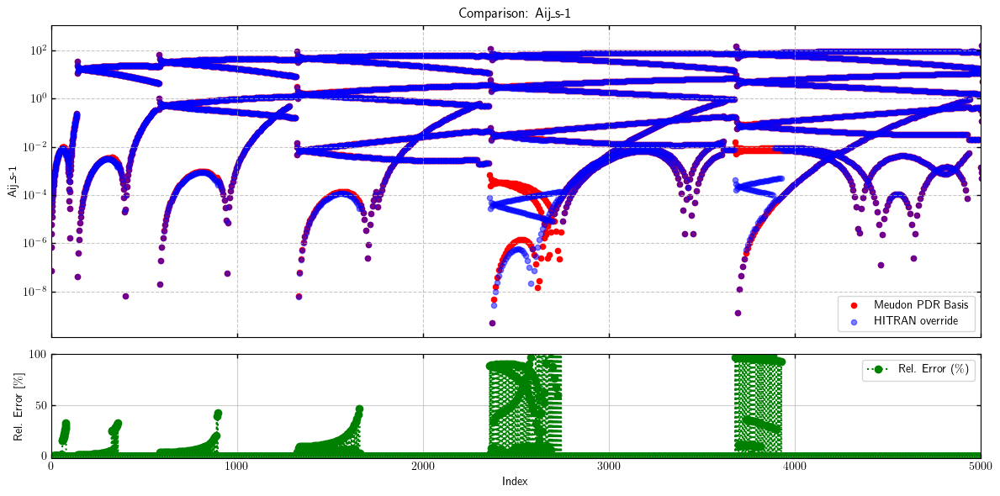

In [9]:
# Graphical check 
#fun.Setting_Figure("Excitation")

fun.plot_comparison(df_co_sorted, df_Hitran_final_sorted, "Frequency_GHz",
                             label1 ="Meudon PDR Basis",label2="HITRAN override",lim=5000)    
fun.plot_comparison(df_co_sorted, df_Hitran_final_sorted, "E_K",
                             label1 ="Meudon PDR Basis",label2="HITRAN override",lim=5000)     
fun.plot_comparison(df_co_sorted, df_Hitran_final_sorted, "Aij_s-1",
                             label1 ="Meudon PDR Basis",label2="HITRAN override",lim=5000)    



### Observation of HITRAN Overide 
We see that there is a minimal relative difference between the old and new data for the Energy and wavelength (linked) but a huge change mainly on the Einstein coefficient Aij. 

We see a jump at low v, because HITRAN data don't go further than v=0 J=80, so there is a jump back to the old data at higher rotational data. Same phenomenon for v=1 and 2.

We see a huge difference in behaviour for v=4-0, 4-4, 5-1 and 5-5 with relative difference more than 100%. This is due to unacurate data calculated in Chandra 1996 for those levels and corrected in HITRAN database. 
Note : after running models on the Meudon PDR Code on an Orion Bar like PDR, we see little difference (under 1%) on those levels in this implementation because this process is orders of magnitude lower than others so even a big change in this secondary process doesn't affect much the final result. 

In [14]:
# Check if we have all data 
pio.renderers.default = "notebook"

df_co_to_check = fun.add_veff(df_co_sorted)
Col = "Aij_s-1"
fun.plot_interactive(df_co_to_check,c_col=Col,log_color=True,
                     hover_cols = ['nu','nl','vu', 'Ju', 'vl', 'Jl'], title="Aij on HITRAN update")

### Observation on matrix filling 
Note : this is an interactive plot so don't hesitate to slide your mouse on the plot to have more informations. 

We observe the rule of delta J = +-1 specificic for CO, so only few diagonals corresponding from left to right to delta v = 4,3,2,1,0. We observe that the delta v = 0 and delta v =4 are less probable than the three other diagonal which have higher rate

In [17]:
# Writing of the combined file with updated data : 

output_path = '/YourPersonalPath/'
output_path = "/Users/aurelien/Desktop/"
output_filename = "line_co_updated.dat" 


fun.write_radiative_coefficient_file(df_co_sorted,output_path+output_filename)



File '/Users/aurelien/Desktop/line_co_updated.dat' created.


## 3. Collision update of H and H2 

Now we will be using the Stancil file to update the collisions with latest data originating from EMA data base and BaseCol database (updated 2025). 

The process here will be a little longer as we have three collisioners (H, ortho H2 and para H2) and one additional dimension (the temperature) with the need to fit to the Meudon PDR temperature grid. 

For each, the data provided range from 2 to 3000 K but the Meudon PDR code needs data from 2 to 20 000K, so we chose to extrapolate every collision coefficient with a constant value identical to the one at 3 000K. For the other points between two temperatures, we chose to do a linear interpolation and we will verify that it fits well the general behaviour of the curves. 


### For H 

In [75]:
df_Stancil_H#.columns

,ID,nu,vu,Ju,nl,vl,Jl,gu,gl,E[cm-1]u,...,500Ke,600Ke,700Ke,800Ke,900Ke,1000Ke,1500Ke,2000Ke,2500Ke,3000Ke
0,1,2,0,1,1,0,0,3,1,3.85,...,2.500000e-11,2.640000e-11,2.750000e-11,2.860000e-11,2.950000e-11,3.030000e-11,3.320000e-11,3.490000e-11,3.570000e-11,3.600000e-11
1,2,3,0,2,1,0,0,5,1,11.53,...,6.310000e-11,6.750000e-11,7.140000e-11,7.490000e-11,7.800000e-11,8.070000e-11,9.120000e-11,9.780000e-11,1.020000e-10,1.050000e-10
2,3,3,0,2,2,0,1,5,3,11.53,...,4.450000e-11,4.770000e-11,5.040000e-11,5.290000e-11,5.530000e-11,5.750000e-11,6.650000e-11,7.300000e-11,7.770000e-11,8.110000e-11
3,4,4,0,3,1,0,0,7,1,23.07,...,8.510000e-12,9.470000e-12,1.040000e-11,1.120000e-11,1.190000e-11,1.260000e-11,1.540000e-11,1.750000e-11,1.900000e-11,2.010000e-11
4,5,4,0,3,2,0,1,7,3,23.07,...,9.850000e-11,1.060000e-10,1.130000e-10,1.190000e-10,1.250000e-10,1.300000e-10,1.490000e-10,1.620000e-10,1.700000e-10,1.760000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17105,17106,236,5,30,216,4,36,61,73,12153.00,...,3.820000e-14,6.860000e-14,9.890000e-14,1.410000e-13,1.830000e-13,2.250000e-13,4.790000e-13,7.470000e-13,1.010000e-12,1.250000e-12
17106,17107,236,5,30,219,4,37,61,75,12153.00,...,3.110000e-14,5.740000e-14,8.360000e-14,1.210000e-13,1.590000e-13,1.970000e-13,4.260000e-13,6.670000e-13,9.020000e-13,1.120000e-12
17107,17108,236,5,30,222,4,38,61,77,12153.00,...,2.520000e-14,4.800000e-14,7.080000e-14,1.060000e-13,1.400000e-13,1.750000e-13,3.970000e-13,6.410000e-13,8.850000e-13,1.110000e-12
17108,17109,236,5,30,225,4,39,61,79,12153.00,...,2.020000e-14,3.970000e-14,5.920000e-14,8.950000e-14,1.200000e-13,1.500000e-13,3.460000e-13,5.550000e-13,7.560000e-13,9.350000e-13


In [21]:
#Prolongation in Temperature > 3 000 K
T_prolongation = [5000,7000,10000,15000,20000]
Col_T_extrapolated = [f"{T}Ke" for T in T_prolongation]



for i in range (len(df_Stancil_H)): 
    line  = df_Stancil_H.iloc[i]
    Extra = fun.prolong_curve(Tvalues_H, line[Col_T_H], T_prolongation,method="flat",x_fit=3000)
    for j in range (len(T_prolongation)) : 
        df_Stancil_H.at[i,str(T_prolongation[j])+"Ke"]=Extra[j]


# Interpolation in Temperature for T= 3 and 7 K 
T_New_H = [3,7]
Col_T_New_H = [f"{T}Ke" for T in T_New_H]

for i in range (len(df_Stancil_H)): 
    line = df_Stancil_H.iloc[i]
    
    xp = [2,5] #For 3K
    fp = [line["2Ke"], line["5Ke"]]
    df_Stancil_H.at[i,"3Ke"] = np.interp(3, xp, fp)
    
    xp = [5,10] #For 7K
    fp = [line["5Ke"], line["10Ke"]]
    df_Stancil_H.at[i,"7Ke"] = np.interp(7, xp, fp)


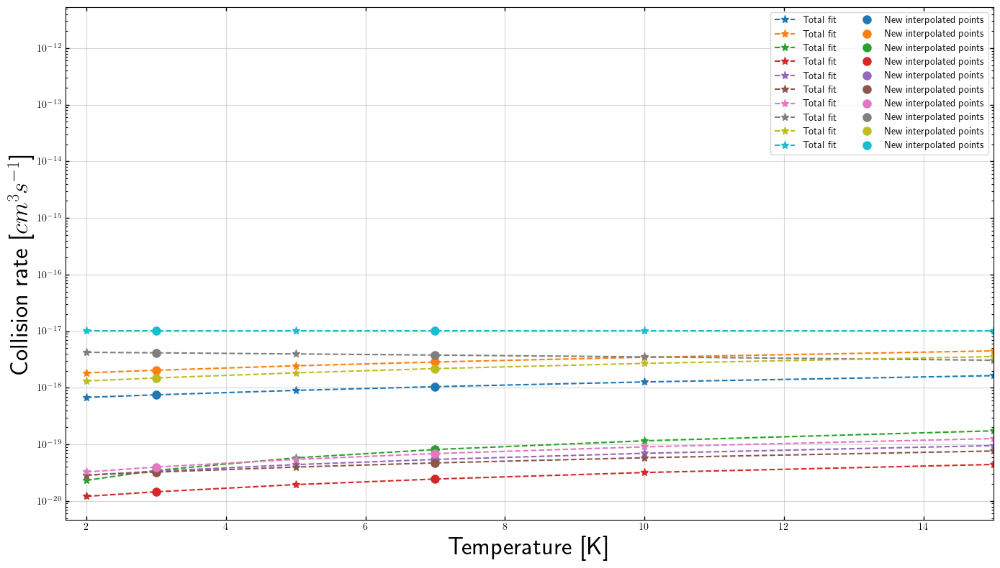

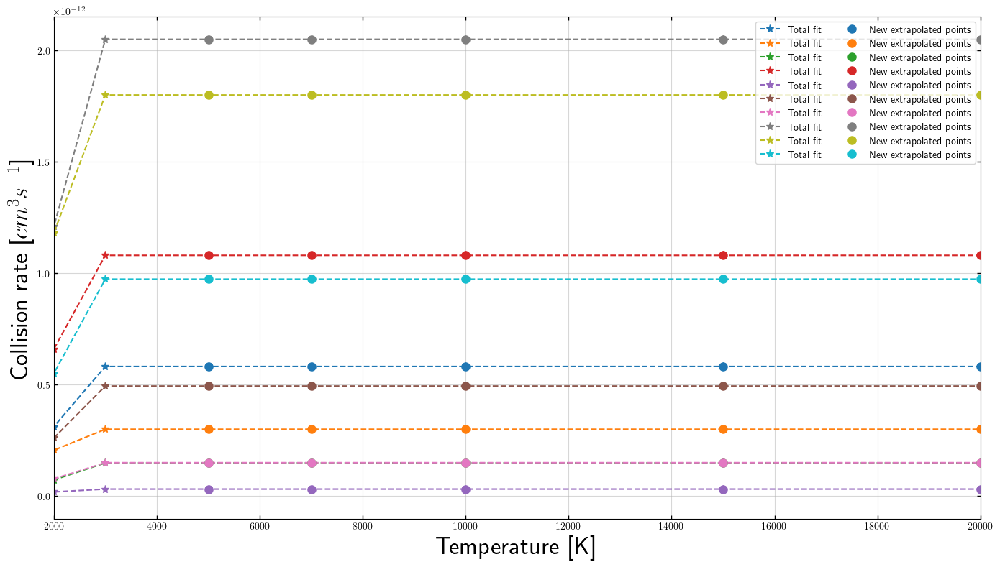

In [22]:
#Check interpolation and prolongation for some random transitions 
sample = df_Stancil_H.sample(n=10)


############ For the interpolation
plt.figure(figsize=(14,8))
for index,row in sample.iterrows() : 
    plt.plot(TGrid_MeudonPDR,row[Col_T_Meudon_int],"*--",label="Total fit",markersize=8)
for index,row in sample.iterrows() : 
    #For lisibilty in the legend 
    plt.plot(T_New_H,row[Col_T_New_H],"o",label="New interpolated points",markersize=8)

plt.grid("--",alpha=0.5)
plt.xlabel("Temperature [K]",fontsize=25)
plt.ylabel(r"Collision rate [$cm^3 s^{-1}$]",fontsize=25)

plt.semilogy()
plt.xlim([1.7,15])
plt.legend(fontsize=10,ncols=2)
plt.tight_layout()  


########## for the extrapolation
plt.figure(figsize=(14,8))
for index,row in sample.iterrows() : 
    plt.plot(TGrid_MeudonPDR,row[Col_T_Meudon_int],"*--",label="Total fit",markersize=8)
for index,row in sample.iterrows() : 
    #For lisibilty in the legend 
    plt.plot(T_prolongation,row[Col_T_extrapolated],"o",label="New extrapolated points",markersize=8)

plt.grid("--",alpha=0.5)
plt.xlabel("Temperature [K]",fontsize=25)
plt.ylabel(r"Collision rate [$cm^3 s^{-1}$]",fontsize=25)

#plt.semilogy()
plt.xlim([2000,20000])
plt.legend(fontsize=10,ncols=2)
plt.tight_layout()  

### Observations : 
The extrapolations in temperatures are acceptable because CO will never receive that much heat in PDR regions 
The interpolations between points is valid and reflects well the general behaviour of the collision rates 

Concerning the comparison, we observe a difference at high temperature resulting from our choice in extrapolation, and we also observe that certain transitions have a huge difference (multiple order of magnitude). This is due to an initial value of 1e-30 to 1e-33 put into the code by Jacques Le Bourlot through an old analytical formula to put them "to 0" with the accurate amount of numbers to fit the format.

### Merge of data between old and new data 

In [24]:
#Merge by adding transitions from the old version to the new grid from Stancil (BaseCol and EMAA)
sorted_transitions = ['vu', 'Ju', 'vl', 'Jl']


df_updated_H  = fun.merge_unique_rows(df_Stancil_H,df_Meudon_H)
#Sort for convenience 
df_updated_H  = df_updated_H.sort_values(by=sorted_transitions, ascending=True)
df_updated_H  = df_updated_H.reset_index(drop=True)
df_updated_H

,ID,nu,vu,Ju,nl,vl,Jl,gu,gl,E[cm-1]u,...,2000Ke,2500Ke,3000Ke,5000Ke,7000Ke,10000Ke,15000Ke,20000Ke,3Ke,7Ke
0,1,2,0,1,1,0,0,3.0,1.0,3.85,...,3.490000e-11,3.570000e-11,3.600000e-11,3.600000e-11,3.600000e-11,3.600000e-11,3.600000e-11,3.600000e-11,1.993333e-11,1.980000e-11
1,2,3,0,2,1,0,0,5.0,1.0,11.53,...,9.780000e-11,1.020000e-10,1.050000e-10,1.050000e-10,1.050000e-10,1.050000e-10,1.050000e-10,1.050000e-10,1.806667e-11,1.948000e-11
2,3,3,0,2,2,0,1,5.0,3.0,11.53,...,7.300000e-11,7.770000e-11,8.110000e-11,8.110000e-11,8.110000e-11,8.110000e-11,8.110000e-11,8.110000e-11,2.666667e-11,2.648000e-11
3,4,4,0,3,1,0,0,7.0,1.0,23.07,...,1.750000e-11,1.900000e-11,2.010000e-11,2.010000e-11,2.010000e-11,2.010000e-11,2.010000e-11,2.010000e-11,1.543333e-12,1.562000e-12
4,5,4,0,3,2,0,1,7.0,3.0,23.07,...,1.620000e-10,1.700000e-10,1.760000e-10,1.760000e-10,1.760000e-10,1.760000e-10,1.760000e-10,1.760000e-10,3.166667e-11,3.332000e-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17105,17106,236,5,30,216,4,36,61.0,73.0,12153.00,...,7.470000e-13,1.010000e-12,1.250000e-12,1.250000e-12,1.250000e-12,1.250000e-12,1.250000e-12,1.250000e-12,8.460000e-18,1.254000e-17
17106,17107,236,5,30,219,4,37,61.0,75.0,12153.00,...,6.670000e-13,9.020000e-13,1.120000e-12,1.120000e-12,1.120000e-12,1.120000e-12,1.120000e-12,1.120000e-12,1.666667e-17,2.332000e-17
17107,17108,236,5,30,222,4,38,61.0,77.0,12153.00,...,6.410000e-13,8.850000e-13,1.110000e-12,1.110000e-12,1.110000e-12,1.110000e-12,1.110000e-12,1.110000e-12,1.676667e-17,2.266000e-17
17108,17109,236,5,30,225,4,39,61.0,79.0,12153.00,...,5.550000e-13,7.560000e-13,9.350000e-13,9.350000e-13,9.350000e-13,9.350000e-13,9.350000e-13,9.350000e-13,1.733333e-17,2.224000e-17


### Vérification graphique 

In [29]:
df_Meudon_H

,ID,nu,nl,vu,Ju,vl,Jl


In [28]:
# Check the relative distance in % between old and new data 
TGrid_MeudonPDR = [2.,3.,5.,7.,10.,15.,20.,30.,50.,70.,100.,150.,200.,300.,500.,700.,1000.,
            1500.,2000.,3000.,5000.,7000.,10000.,15000.,20000.]


import Functions as fun
import importlib
importlib.reload(fun)


Col_T_Meudon = [f"{T}Ke" for T in TGrid_MeudonPDR]
Col_T_Meudon_int = [f"{int(T)}Ke" for T in TGrid_MeudonPDR]
sorted_transitions = ['vu', 'Ju', 'vl', 'Jl','nu','nl']

df_H_comparison_onnew = fun.abs_rel_error(df_updated_H,df_Meudon_H,sorted_transitions,Col_T_Meudon_int)#Useless unless if you want to compare on new data
df_H_comparison_onref = fun.abs_rel_error(df_Meudon_H,df_updated_H,sorted_transitions,Col_T_Meudon_int)


df_H_comparison_onref

KeyError: '2KeKe_1'

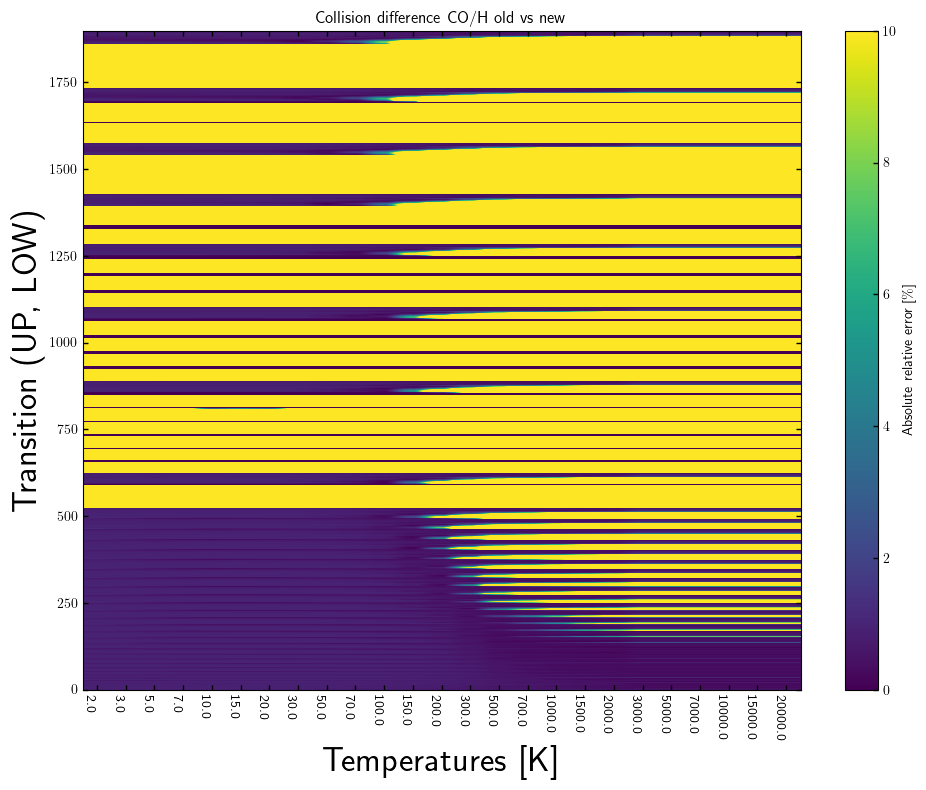

In [23]:
#2D histogram of relative difference in % between old and new transitions 
columns_compare = [f"{c}_err" for c in Col_T_Meudon_int]
df_data = df_H_comparison_onref[columns_compare]
liste_de_floats = [float(col.replace('Ke_err', '')) for col in columns_compare]
#y_labels = [f"UP={row['UP']}, LOW={row['LOW']}" for _, row in df_difference_filtre[['UP', 'LOW']].iterrows()]


data = df_data.to_numpy()

fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(data, cmap="viridis", aspect='auto', origin='lower', vmin=0, vmax=10)
fig.colorbar(im, ax=ax, label=r'Absolute relative error [$\%$]')

#ax.set_yticks(np.arange(len(df_comparaison_H_new.index)))
ax.set_xticks(np.arange(len(columns_compare)))
#ax.set_yticklabels(y_labels)
ax.set_xticklabels(liste_de_floats)

plt.setp(ax.get_xticklabels(), rotation=-90, ha="right")
ax.set_ylabel('Transition (UP, LOW)',size=25)
ax.set_xlabel('Temperatures [K]',size=25)
ax.set_title('Collision difference CO/H old vs new')

plt.tight_layout()
plt.show()


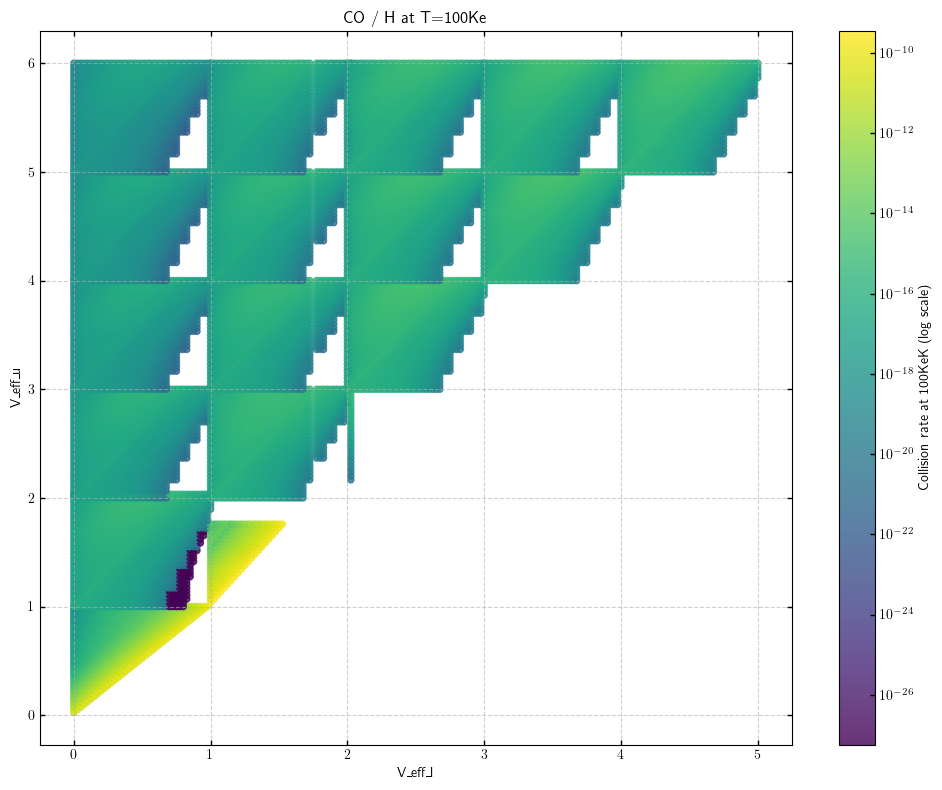

'We created a new scale with \n- for y axis :  vu as integer and Ju as decimal so (vu,Ju)=(1,5) is 1.5 in the figure. \n- for x axis :  vl as integer and Jl as decimal \nOtherwise, use the interactive plotly figure to see the details point by point for the vu,Ju,vl,Jl and additional informations. \n'

In [68]:
pio.renderers.default = 'notebook' 

df_matrix_h = mod.sort_and_create_effective_values(df_updated_H) #merge vu,Ju together to have a more efficient scale for x and y

Col= "100Ke"
mod.plot_static_colormap(df_matrix_h,c_col=Col,log_color_scale=True,title =f"CO / H at T={Col}" )
mod.plot_interactive_plotly(df_matrix_h,c_col=Col,log_color_scale=True,
                            hover_cols = ['nu','nl','vu', 'Ju', 'vl', 'Jl'],title=f"CO / H at T={Col}")

"""We created a new scale with 
- for y axis :  vu as integer and Ju as decimal so (vu,Ju)=(1,5) is 1.5 in the figure. 
- for x axis :  vl as integer and Jl as decimal 
Otherwise, use the interactive plotly figure to see the details point by point for the vu,Ju,vl,Jl and additional informations. 
"""

### Observations : 
We see that the matrix is not complete, but we also observe that the holes appear at the lowest collision rates, and are nowhere to be found. 
We also highlight that the only collision rates remaining from the old version code are noticeable at vu=1 towards vl=0 high Jl. Those collision rates remain at 10^-26 because no calculation have been performed on those values. 
In addition we observe that the diagonal terms corresponding to delta v=0 delta J =+-1 are the highest collision rates and we would expect as a further update to add the collision rates for vu=1 high Ju towards vl=1 if calculated. 

In [69]:
#Write the new collision file to the Meudon PDR format : 
df_updated_H['NUM'] = df_updated_H.index + 1

#Write the update to the Meudon PDR format 
path = "YourPath/"
create_coll_data(df_updated_H, num_energy_levels=236,
                 filename=path+"coll_co_h_updated.dat")

Fichier '/Users/aurelien/Desktop/coll_co_h_updated.dat' créé avec succès.


## 4 Update of CO-H2 collisions 
Same procedure is applied to ortho and para H2 which originate from Stancil file (EMAA and Basecol data) from Yang 2015 and Castro 2017 research. 

In [36]:
df_Stancil_oH2

,ID,nu,vu,Ju,nl,vl,Jl,gu,gl,E[cm-1]u,...,400Ke,500Ke,600Ke,700Ke,750Ke,800Ke,900Ke,1000Ke,2000Ke,3000Ke
0,1,2,0,1,1,0,0,3,1,3.85,...,3.730000e-11,3.730000e-11,3.730000e-11,3.730000e-11,3.730000e-11,3.740000e-11,3.750000e-11,3.760000e-11,3.950000e-11,4.170000e-11
1,2,3,0,2,1,0,0,5,1,11.53,...,4.840000e-11,5.080000e-11,5.260000e-11,5.420000e-11,5.490000e-11,5.560000e-11,5.670000e-11,5.780000e-11,6.510000e-11,6.960000e-11
2,3,3,0,2,2,0,1,5,3,11.53,...,7.290000e-11,7.410000e-11,7.500000e-11,7.580000e-11,7.610000e-11,7.640000e-11,7.700000e-11,7.760000e-11,8.250000e-11,8.640000e-11
3,4,4,0,3,1,0,0,7,1,23.07,...,1.580000e-11,1.650000e-11,1.700000e-11,1.740000e-11,1.750000e-11,1.770000e-11,1.790000e-11,1.810000e-11,1.950000e-11,2.030000e-11
4,5,4,0,3,2,0,1,7,3,23.07,...,7.630000e-11,8.030000e-11,8.390000e-11,8.690000e-11,8.830000e-11,8.970000e-11,9.210000e-11,9.420000e-11,1.090000e-10,1.180000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5520,5521,224,5,20,219,4,37,41,75,11221.00,...,3.680000e-17,1.230000e-16,3.110000e-16,6.510000e-16,8.940000e-16,1.190000e-15,1.990000e-15,3.090000e-15,8.720000e-19,8.700000e-14
5521,5522,224,5,20,220,5,17,41,35,11221.00,...,8.010000e-11,8.210000e-11,8.320000e-11,8.390000e-11,8.420000e-11,8.440000e-11,8.480000e-11,8.520000e-11,7.280000e-11,9.240000e-11
5522,5523,224,5,20,221,5,18,41,37,11221.00,...,7.990000e-11,8.870000e-11,9.540000e-11,1.010000e-10,1.030000e-10,1.050000e-10,1.090000e-10,1.130000e-10,5.530000e-11,1.560000e-10
5523,5524,224,5,20,222,4,38,41,77,11221.00,...,3.320000e-17,1.120000e-16,2.760000e-16,5.620000e-16,7.630000e-16,1.010000e-15,1.670000e-15,2.580000e-15,4.670000e-19,8.310000e-14


In [39]:
#Extrapolation at high temperature (same as for H)
T_prolongation = [5000,7000,10000,15000,20000]
Col_T_extrapolated = [f"{T}Ke" for T in T_prolongation]
#Ortho H2
for i in range (len(df_Stancil_oH2)): 
    line= df_Stancil_oH2.iloc[i]
    Extra =calculate.curve_prolongation(Tvalues_H2, line[Col_T_H2], T_prolongation,method="flat",x_fit_start=3000)
    for j in range (len(T_prolongation)) : 
        df_Stancil_oH2.at[i,str(T_prolongation[j])+"Ke"]=Extra[j]
#para H2
for i in range (len(df_Stancil_pH2)): 
    line= df_Stancil_pH2.iloc[i]
    Extra =calculate.curve_prolongation(Tvalues_H2, line[Col_T_H2], T_prolongation,method="flat",x_fit_start=3000)
    for j in range (len(T_prolongation)) : 
        df_Stancil_pH2.at[i,str(T_prolongation[j])+"Ke"]=Extra[j]

        
# Interpolation in Temperature for T= 3 and 7 K but also for 15 and 1 500K
#Ortho H2
T_New_H2 = [3,7]
Col_T_New_H2 = [f"{T}Ke" for T in T_New_H2]

for i in range (len(df_Stancil_oH2)): 
    ligne= df_Stancil_oH2.iloc[i]
    
    xp = [2,5]
    fp = [ligne["2Ke"], ligne["5Ke"]]
    df_Stancil_oH2.at[i,"3Ke"] = np.interp(3, xp, fp)
    
    xp = [5,10]
    fp = [ligne["5Ke"], ligne["10Ke"]]
    df_Stancil_oH2.at[i,"7Ke"] = np.interp(7, xp, fp)
    
    xp = [10,20]
    fp = [ligne["10Ke"], ligne["20Ke"]]
    df_Stancil_oH2.at[i,"15Ke"] = np.interp(15, xp, fp)
    
    xp = [1000,2000]
    fp = [ligne["1000Ke"], ligne["2000Ke"]]
    df_Stancil_oH2.at[i,"1500Ke"] = np.interp(1500, xp, fp)

#Para H2
for i in range (len(df_Stancil_pH2)): 
    ligne= df_Stancil_pH2.iloc[i]
    
    xp = [2,5]
    fp = [ligne["2Ke"], ligne["5Ke"]]
    df_Stancil_pH2.at[i,"3Ke"] = np.interp(3, xp, fp)
    
    xp = [5,10]
    fp = [ligne["5Ke"], ligne["10Ke"]]
    df_Stancil_pH2.at[i,"7Ke"] = np.interp(7, xp, fp)
    
    xp = [10,20]
    fp = [ligne["10Ke"], ligne["20Ke"]]
    df_Stancil_pH2.at[i,"15Ke"] = np.interp(15, xp, fp)
    
    xp = [1000,2000]
    fp = [ligne["1000Ke"], ligne["2000Ke"]]
    df_Stancil_pH2.at[i,"1500Ke"] = np.interp(1500, xp, fp)
    


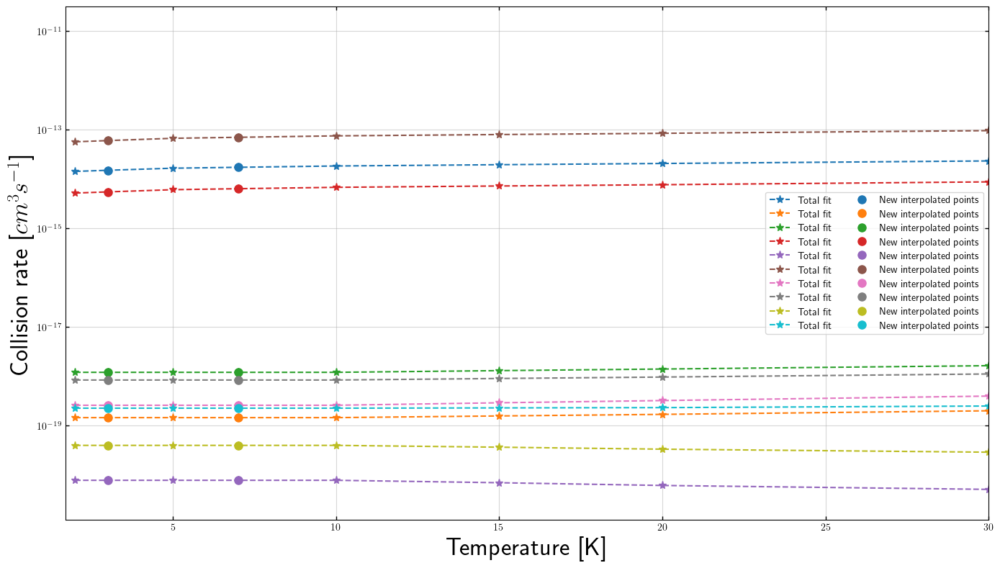

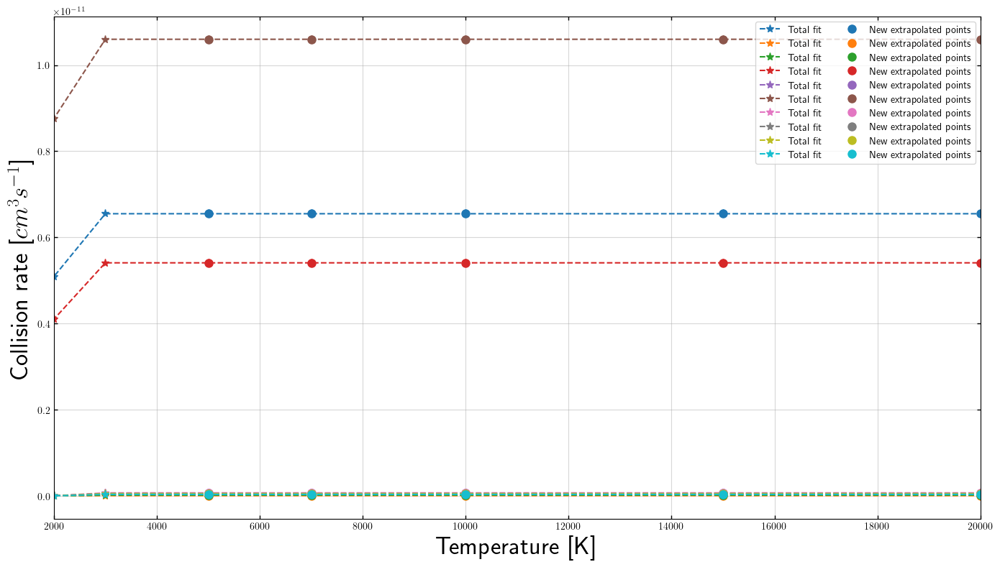

In [46]:
#Check interpolation and prolongation for some random transitions 
sample_ortho = df_Stancil_oH2.sample(n=10)
sample_para  = df_Stancil_pH2.sample(n=10)


############ For the interpolation
plt.figure(figsize=(14,8))

for index,row in sample_ortho.iterrows() : 
    plt.plot(TGrid_MeudonPDR,row[Col_T_Meudon_int],"*--",label="Total fit",markersize=8)
for index,row in sample_ortho.iterrows() : 
    #For lisibilty in the legend 
    plt.plot(T_New_H,row[Col_T_New_H2],"o",label="New interpolated points",markersize=8)

plt.grid("--",alpha=0.5)
plt.xlabel("Temperature [K]",fontsize=25)
plt.ylabel(r"Collision rate [$cm^3 s^{-1}$]",fontsize=25)
plt.semilogy()
plt.xlim([1.7,30])
plt.legend(fontsize=10,ncols=2)
plt.tight_layout()  


########## for the extrapolation
plt.figure(figsize=(14,8))
for index,row in sample_ortho.iterrows() : 
    plt.plot(TGrid_MeudonPDR,row[Col_T_Meudon_int],"*--",label="Total fit",markersize=8)
for index,row in sample_ortho.iterrows() : 
    #For lisibilty in the legend 
    plt.plot(T_prolongation,row[Col_T_extrapolated],"o",label="New extrapolated points",markersize=8)

plt.grid("--",alpha=0.5)
plt.xlabel("Temperature [K]",fontsize=25)
plt.ylabel(r"Collision rate [$cm^3 s^{-1}$]",fontsize=25)
#plt.semilogy()
plt.xlim([2000,20000])
plt.legend(fontsize=10,ncols=2)
plt.tight_layout()  

In [51]:
#merge the data between new and old 

#ortho H2
df_updated_oH2  = merge_unique_rows(df_Stancil_oH2,df_Meudon_oH2)
df_updated_oH2  = df_updated_oH2.sort_values(by=sorted_transitions, ascending=True)
df_updated_oH2  = df_updated_oH2.reset_index(drop=True)


#para H2
df_updated_pH2  = merge_unique_rows(df_Stancil_pH2,df_Meudon_pH2)
df_updated_pH2  = df_updated_pH2.sort_values(by=sorted_transitions, ascending=True)
df_updated_pH2  = df_updated_pH2.reset_index(drop=True)
df_updated_pH2




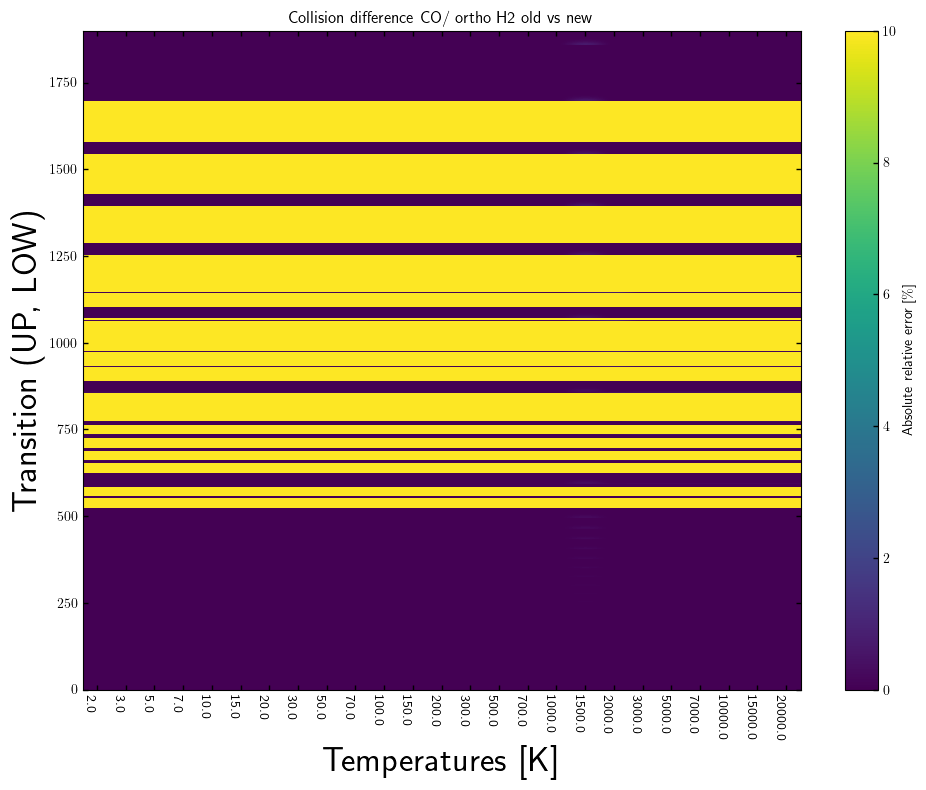

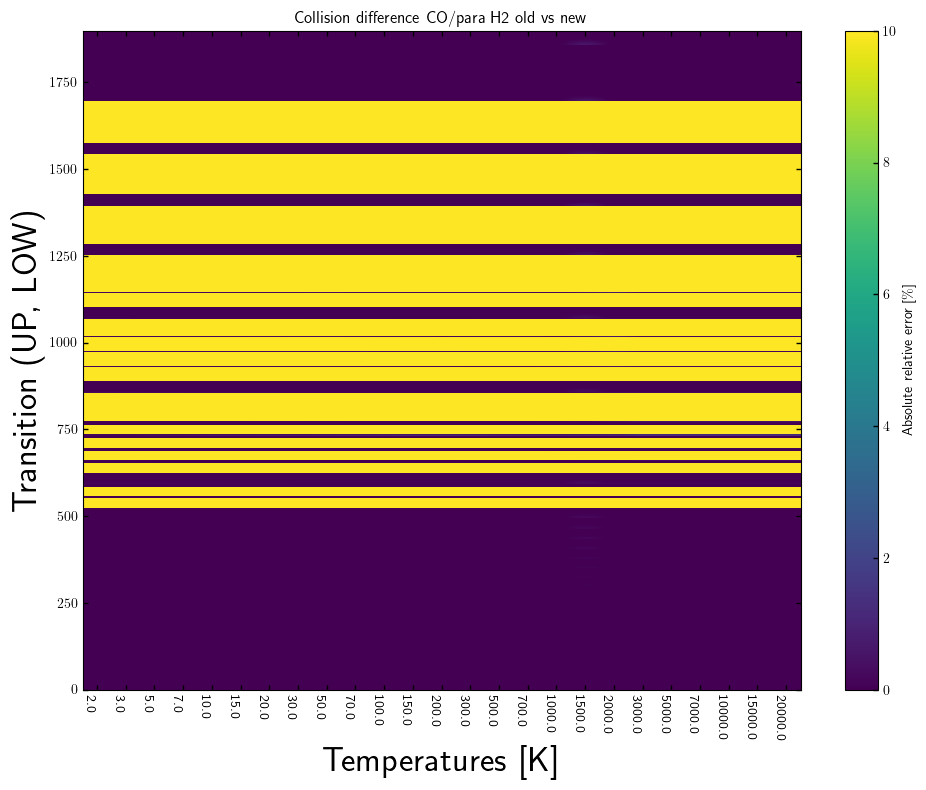

In [53]:
#Check comparison when updated

df_oH2_comparison_onref = abs_rel_error(df_Meudon_oH2,df_updated_oH2,sorted_transitions,Col_T_Meudon_int)
df_pH2_comparison_onref = abs_rel_error(df_Meudon_pH2,df_updated_pH2,sorted_transitions,Col_T_Meudon_int)

#Ortho H2 
df_data = df_oH2_comparison_onref[columns_compare]
liste_de_floats = [float(col.replace('Ke_err', '')) for col in columns_compare]

data = df_data.to_numpy()

fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(data, cmap="viridis", aspect='auto', origin='lower', vmin=0, vmax=10)
fig.colorbar(im, ax=ax, label=r'Absolute relative error [$\%$]')

#ax.set_yticks(np.arange(len(df_comparaison_H_new.index)))
ax.set_xticks(np.arange(len(columns_compare)))
#ax.set_yticklabels(y_labels)
ax.set_xticklabels(liste_de_floats)

plt.setp(ax.get_xticklabels(), rotation=-90, ha="right")
ax.set_ylabel('Transition (UP, LOW)',size=25)
ax.set_xlabel('Temperatures [K]',size=25)
ax.set_title('Collision difference CO/ ortho H2 old vs new')

plt.tight_layout()
plt.show()



#####para H2
df_data = df_pH2_comparison_onref[columns_compare]
liste_de_floats = [float(col.replace('Ke_err', '')) for col in columns_compare]

data = df_data.to_numpy()

fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(data, cmap="viridis", aspect='auto', origin='lower', vmin=0, vmax=10)
fig.colorbar(im, ax=ax, label=r'Absolute relative error [$\%$]')

#ax.set_yticks(np.arange(len(df_comparaison_H_new.index)))
ax.set_xticks(np.arange(len(columns_compare)))
#ax.set_yticklabels(y_labels)
ax.set_xticklabels(liste_de_floats)

plt.setp(ax.get_xticklabels(), rotation=-90, ha="right")
ax.set_ylabel('Transition (UP, LOW)',size=25)
ax.set_xlabel('Temperatures [K]',size=25)
ax.set_title('Collision difference CO/para H2 old vs new')

plt.tight_layout()
plt.show()


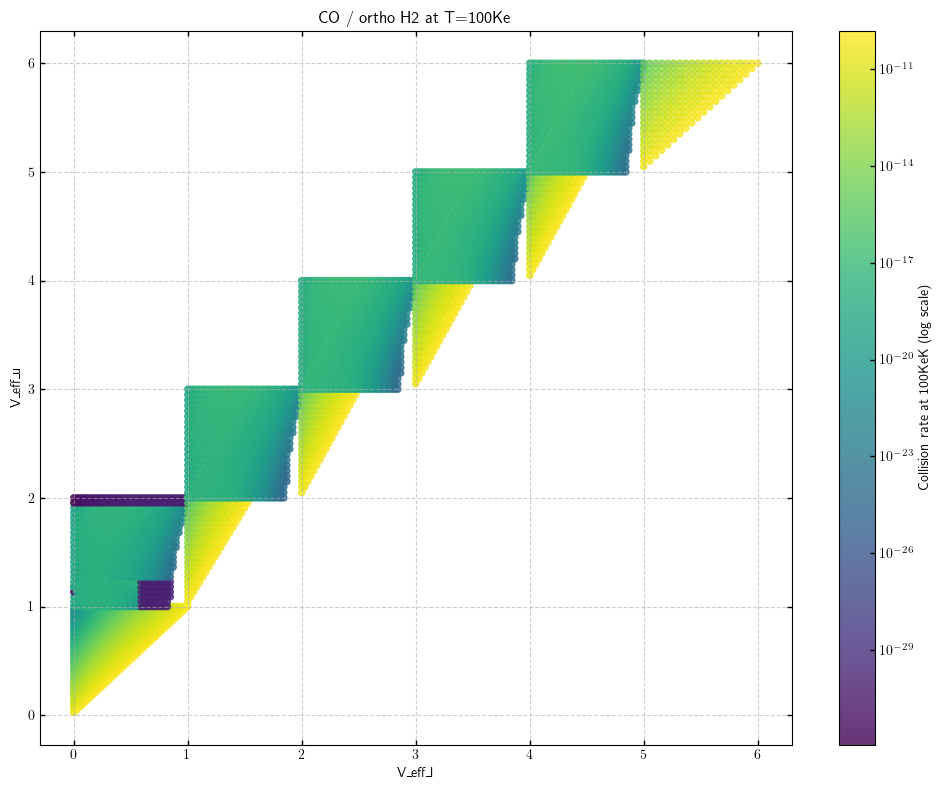

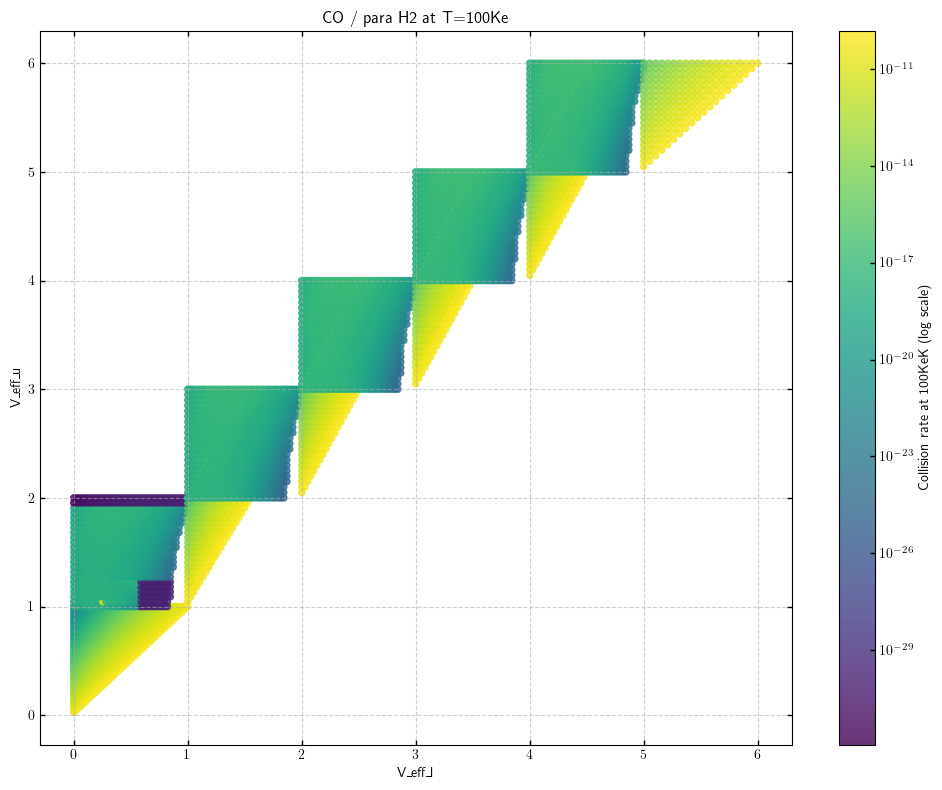

'We created a new scale with \n- for y axis :  vu as integer and Ju as decimal so (vu,Ju)=(1,5) is 1.5 in the figure. \n- for x axis :  vl as integer and Jl as decimal \nOtherwise, use the interactive plotly figure to see the details point by point for the vu,Ju,vl,Jl and additional informations. \n'

In [56]:
pio.renderers.default = 'notebook' 

#ortho H2
df_matrix_oh2 = mod.sort_and_create_effective_values(df_updated_oH2) #merge vu,Ju together to have a more efficient scale for x and y
Col= "100Ke"
mod.plot_static_colormap(df_matrix_oh2,c_col=Col,log_color_scale=True,title =f"CO / ortho H2 at T={Col}" )
mod.plot_interactive_plotly(df_matrix_oh2,c_col=Col,log_color_scale=True,
                            hover_cols = ['nu','nl','vu', 'Ju', 'vl', 'Jl'],title=f"CO / ortho H2 at T={Col}")

#para H2
df_matrix_ph2 = mod.sort_and_create_effective_values(df_updated_pH2) #merge vu,Ju together to have a more efficient scale for x and y
Col= "100Ke"
mod.plot_static_colormap(df_matrix_ph2,c_col=Col,log_color_scale=True,title =f"CO / para H2 at T={Col}" )
mod.plot_interactive_plotly(df_matrix_ph2,c_col=Col,log_color_scale=True,
                            hover_cols = ['nu','nl','vu', 'Ju', 'vl', 'Jl'],title=f"CO / para H2 at T={Col}")


"""We created a new scale with 
- for y axis :  vu as integer and Ju as decimal so (vu,Ju)=(1,5) is 1.5 in the figure. 
- for x axis :  vl as integer and Jl as decimal 
Otherwise, use the interactive plotly figure to see the details point by point for the vu,Ju,vl,Jl and additional informations. 
"""

### Observation : 
Same remark as for H, but we see here the collision rates are less complete : we don't have the transitions delta v =3 and 4 as for H. 
We observe also the remaining data from the old code at vu=1 low Ju towards vl=0 high Jl + one point at vu,Ju = (1,3) towards (0,0) for ortho H2. After 2 checks on EMAA database and Basecol, this is not an error and this transition doesn't appear in their database. 

In [59]:
df_updated_oH2

,ID,nu,vu,Ju,nl,vl,Jl,gu,gl,E[cm-1]u,...,3000Ke,5000Ke,7000Ke,10000Ke,15000Ke,20000Ke,3Ke,7Ke,15Ke,1500Ke
0,1.0,2.0,0,1,1.0,0,0,3.0,1.0,3.85,...,4.170000e-11,4.170000e-11,4.170000e-11,4.170000e-11,4.170000e-11,4.170000e-11,4.220000e-11,4.056000e-11,3.630000e-11,3.855000e-11
1,2.0,3.0,0,2,1.0,0,0,5.0,1.0,11.53,...,6.960000e-11,6.960000e-11,6.960000e-11,6.960000e-11,6.960000e-11,6.960000e-11,5.930000e-11,5.326000e-11,4.850000e-11,6.145000e-11
2,3.0,3.0,0,2,2.0,0,1,5.0,3.0,11.53,...,8.640000e-11,8.640000e-11,8.640000e-11,8.640000e-11,8.640000e-11,8.640000e-11,7.950000e-11,6.778000e-11,6.015000e-11,8.005000e-11
3,4.0,4.0,0,3,1.0,0,0,7.0,1.0,23.07,...,2.030000e-11,2.030000e-11,2.030000e-11,2.030000e-11,2.030000e-11,2.030000e-11,6.206667e-12,6.784000e-12,7.180000e-12,1.880000e-11
4,5.0,4.0,0,3,2.0,0,1,7.0,3.0,23.07,...,1.180000e-10,1.180000e-10,1.180000e-10,1.180000e-10,1.180000e-10,1.180000e-10,7.620000e-11,8.092000e-11,8.225000e-11,1.016000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5708,5519.0,224.0,5,20,217.0,5,15,41.0,31.0,11221.00,...,6.090000e-11,6.090000e-11,6.090000e-11,6.090000e-11,6.090000e-11,6.090000e-11,1.650000e-11,1.650000e-11,1.745000e-11,4.065000e-11
5709,5520.0,224.0,5,20,218.0,5,16,41.0,33.0,11221.00,...,6.180000e-11,6.180000e-11,6.180000e-11,6.180000e-11,6.180000e-11,6.180000e-11,1.220000e-11,1.220000e-11,1.270000e-11,2.790000e-11
5710,5522.0,224.0,5,20,220.0,5,17,41.0,35.0,11221.00,...,9.240000e-11,9.240000e-11,9.240000e-11,9.240000e-11,9.240000e-11,9.240000e-11,5.030000e-11,5.030000e-11,5.295000e-11,7.900000e-11
5711,5523.0,224.0,5,20,221.0,5,18,41.0,37.0,11221.00,...,1.560000e-10,1.560000e-10,1.560000e-10,1.560000e-10,1.560000e-10,1.560000e-10,3.410000e-11,3.410000e-11,3.590000e-11,8.415000e-11


In [67]:
df_updated_oH2['NUM'] = df_updated_oH2.index + 1
df_updated_pH2['NUM'] = df_updated_pH2.index + 1

#Write the update to the Meudon PDR format 

path = "YourPath/"

create_coll_data(df_updated_oH2, num_energy_levels=224,
                 filename=path+"coll_co_oh2_updated.dat")

create_coll_data(df_updated_pH2, num_energy_levels=224,
                 filename=path+"coll_co_ph2_updated.dat")


FileNotFoundError: [Errno 2] No such file or directory: 'YourPath/coll_co_oh2_updated.dat'